In [50]:
import numpy as np

In [51]:
array = np.fromfile("/home/jc/Project/CViewer/GitLab/CViewer/sample/Sample_MIPIRAW10bit_Pattern_RGGB_W4000_H3000.raw",np.uint8).astype(np.uint16)

In [52]:
def mipiraw10toraw(mipiraw10_array: np.ndarray):
    "This is the lossless conversion method of mipi raw to raw."
    mipiraw10_array = mipiraw10_array.reshape((-1,5)).astype(np.uint16)
    mipiraw10_array[:,0] = np.left_shift(mipiraw10_array[:,0],2)
    mipiraw10_array[:,1] = np.left_shift(mipiraw10_array[:,1],2)
    mipiraw10_array[:,2] = np.left_shift(mipiraw10_array[:,2],2)
    mipiraw10_array[:,3] = np.left_shift(mipiraw10_array[:,3],2)
    mipiraw10_array[:,0] = mipiraw10_array[:,0] | np.bitwise_and(mipiraw10_array[:,4],0x3)
    mipiraw10_array[:,1] = mipiraw10_array[:,1] | np.bitwise_and(np.right_shift(mipiraw10_array[:,4],2),0x3)
    mipiraw10_array[:,2] = mipiraw10_array[:,2] | np.bitwise_and(np.right_shift(mipiraw10_array[:,4],4),0x3)
    mipiraw10_array[:,3] = mipiraw10_array[:,3] | np.bitwise_and(np.right_shift(mipiraw10_array[:,4],6),0x3)
    return mipiraw10_array

In [53]:
mipiraw10_array = mipiraw10toraw(array)

In [54]:
mipiraw10_array[0:10,0]

array([202, 200, 212, 228, 213, 247, 275, 263, 260, 284], dtype=uint16)

In [55]:
array

array([ 50,  29,  52, ...,  29,  51, 101], dtype=uint16)

In [35]:
from PIL import Image

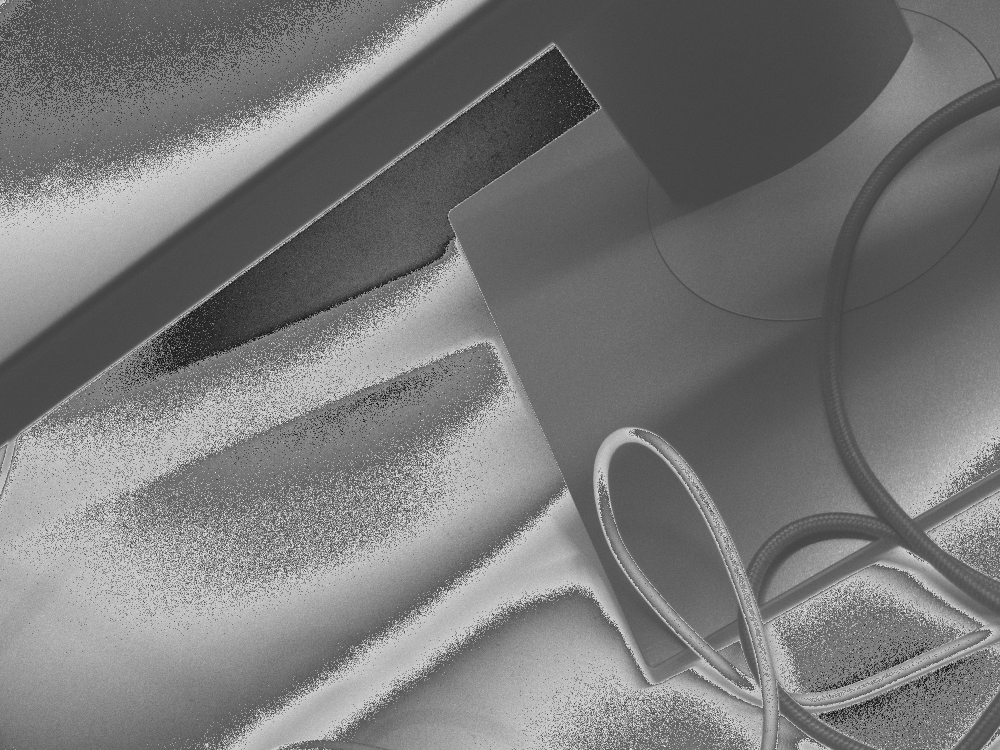

In [36]:
Image.fromarray(mipiraw10_array.astype(np.uint8).reshape(3000,4000))

In [37]:
def raw2rgb(raw_array:np.ndarray, width:int, height:int, pattern:str, gain:float):
    "This is the method to convert from raw format to RGB format."
    channels = {'R': [1, 0, 0], 'G': [0, 1, 0], 'B': [0, 0, 1]}
    channel_marker = np.zeros([height, width, 3])
    for channel, (y, x) in zip(pattern, [(0, 0), (0, 1), (1, 0), (1, 1)]):
        channel_marker[y::2, x::2] = channels[channel]
    channel_marker = channel_marker.reshape([width * height, 3]).T
    rgb_array = (raw_array * channel_marker).T
    rgb_array = rgb_array.reshape([height, width, 3])     
    if abs(1.000000 - gain) > 0.000001:
        rgb_array = rgb_array*gain
    rgb_array[rgb_array>255] = 255
    rgb_array[rgb_array<0] = 0
    return rgb_array.astype(np.uint8)

In [38]:
raw_data = raw2rgb(mipiraw10_array.reshape(1,-1),4000,3000,"RGGB",1)

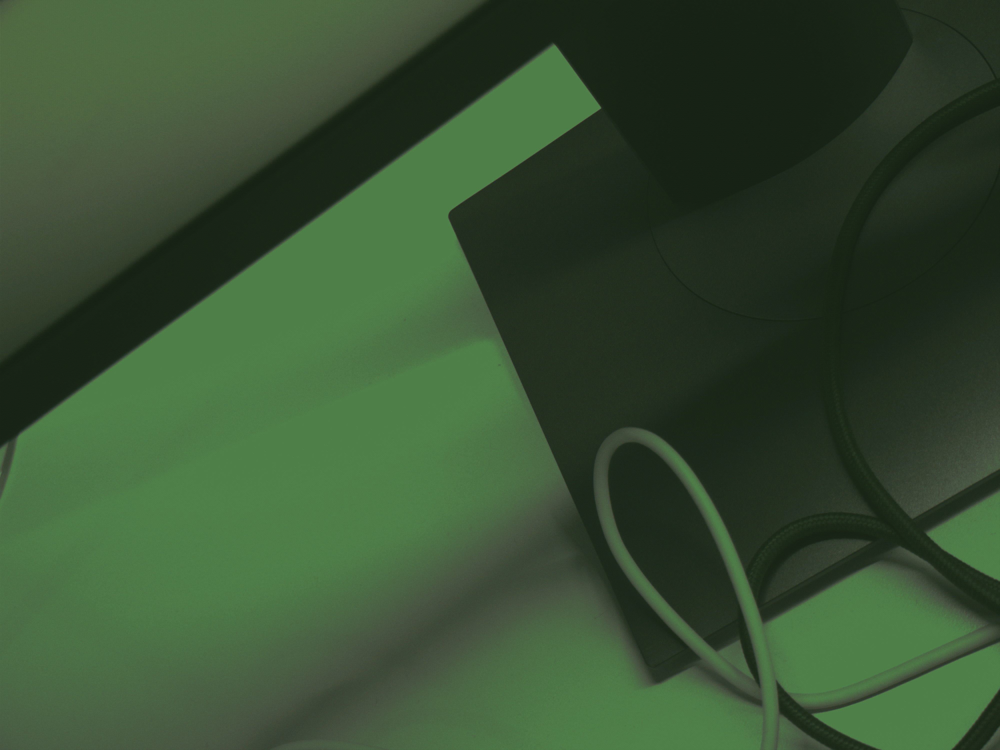

In [39]:
Image.fromarray(raw_data.astype(np.uint8))